# OCR - From images to text

In this notebook, we're going to see how we can extract text from images using the ```pytesseract``` library. However, we're going to touch on a lot of different skills we've learned this semester - including drawing on ideas from Language Analytics, too!

In [ ]:
#run the setup scrript from Ross repo, to have the right packages installed

In [1]:
# basic python tools
import re, os, sys
sys.path.append("..")

# OCR tools
import cv2
import pytesseract

# util functions
from utils.imutils import jimshow as show
from utils.imutils import jimshow_channel as show_channel

# data processing tools
import numpy as np 
import pandas as pd 

# readymade spellchecker
from autocorrect import Speller

def clean_string(string):
    """Removes punctuation to assist in OCR correction"""
    processed = string.replace("\n"," ")\
                     .replace("\n\n"," ")\
                     .replace("__"," ")\
                     .replace(" - "," ")\
                     .replace('-""' ," ")\
                     .replace("|", "")\
                     .replace("!", "")\
                     .replace("\s\s"," ")\
                     .lstrip()
    return " ".join(processed.split())

## OCR using ```Tesseract```

Tesseract/pytesseract is quite a rich library with lots of different functionality and small tweaks and tricks that can improve your OCR. Check out the documentation for more info:

**Pytesseract:** [Github](https://github.com/h/pytesseract) <br><br>
**Tesseract:** [Github](https://github.com/tesseract-ocr/tesseract); [Documentation](https://tesseract-ocr.github.io/)

In [2]:
filepath = os.path.join("..", 
                        "..",
                        "..",
                        "..",
                        "cds-vis-data",
                        "data", 
                        "img", 
                        "jefferson.jpg")

The simplest way of using ```pytesseract``` is simply to call the ```.image_to_string()```. As the name suggests, this produces a single string with all of the text content found in the image:

In [3]:
text = pytesseract.image_to_string(filepath)
print(text)

 

3 CREATOR X
RIGHTS, AMONG ; THESE AREL

   
      
 
 
 
   
  

 
   

ANE D THE PURSUIT OF Yaak THAT

  

"SOLEMNLY eres AND DE SARE, THAT _

 
 
   
    
  

 

'D Pia — OF THIS aa
DECLARATION, WITH A out RELIANCE aoa

  

  

PROVIDENCE, WE UTUALLY PLE GE )

ia See Re

“OUR LIVES,|OUR F FORTUNES-AND OUR

   



The library also has a method for returning the information as a dataframe which contains a detailed collection of information about its predictions:

In [4]:
df = pytesseract.image_to_data(filepath, 
                               output_type='data.frame')

In [5]:
df

,level,page_num,block_num,par_num,line_num,word_num,left,top,width,height,conf,text
0,1,1,0,0,0,0,0,0,4320,3240,-1,NaN
1,2,1,1,0,0,0,0,0,4320,1276,-1,NaN
2,3,1,1,1,0,0,0,0,4320,1276,-1,NaN
3,4,1,1,1,1,0,0,0,4320,1276,-1,NaN
4,5,1,1,1,1,1,0,0,4320,1276,95,
...,...,...,...,...,...,...,...,...,...,...,...,...
128,2,1,16,0,0,0,1775,3176,717,64,-1,NaN
129,3,1,16,1,0,0,1775,3176,717,64,-1,NaN
130,4,1,16,1,1,0,1775,3176,717,64,-1,NaN
131,5,1,16,1,1,1,1775,3176,49,64,95,


## Preprocess with Open-CV

Note that Tesseract on Github give a bunch of tips for how best to preprocess images to improve performance. 

You should have the skills to actually do all of these things using OpenCV: https://github.com/tesseract-ocr/tessdoc/blob/main/ImproveQuality.md#rescaling

In [6]:
image = cv2.imread(filepath)

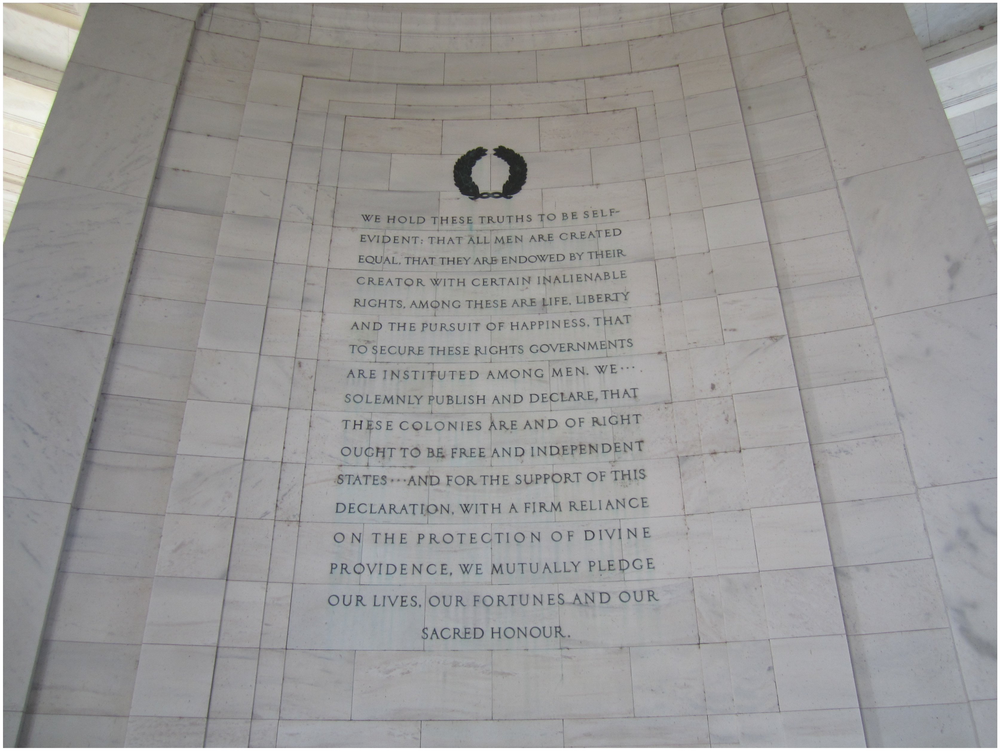

In [7]:
show(image)

__Crop__

The first thing we want to do is to crop this around the center of the image to keep only the main text.

In [8]:
(cX, cY) = (image.shape[1]//2, image.shape[0]//2)
cropped = image[cY-750:cY+1150, cX-750:cX+700] #from manual expection this is best 

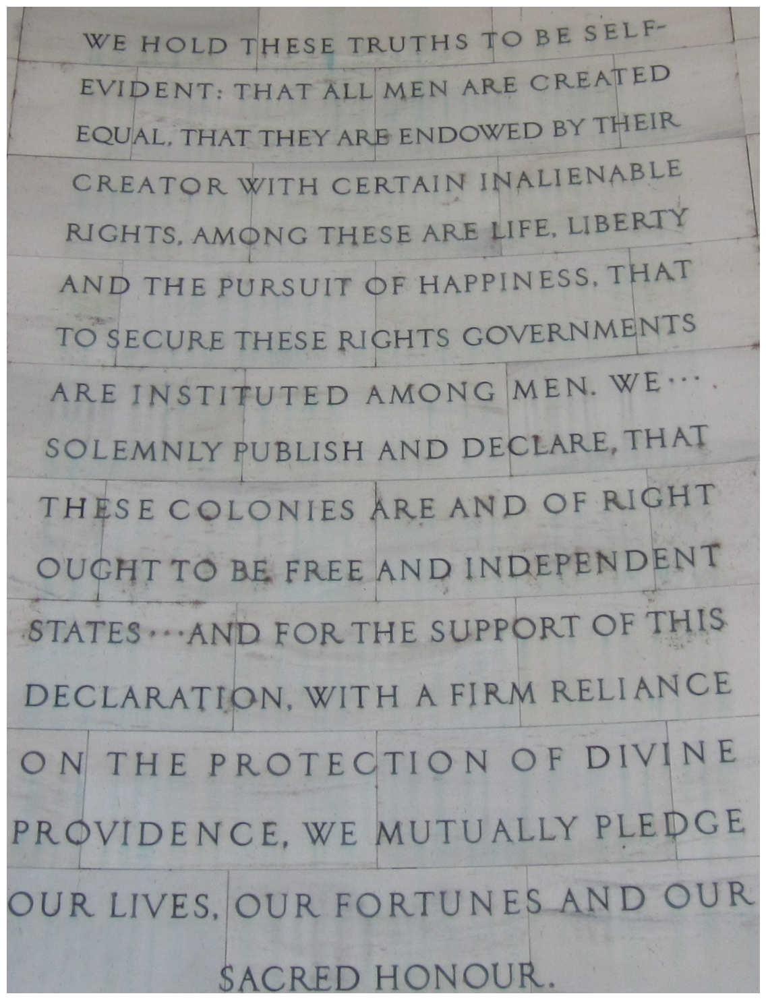

In [10]:
show(cropped)

__Greyscale__

Next, we greyscale the image to attempt to remove extra noise.

In [11]:
grey = cv2.cvtColor(cropped, cv2.COLOR_BGR2GRAY)

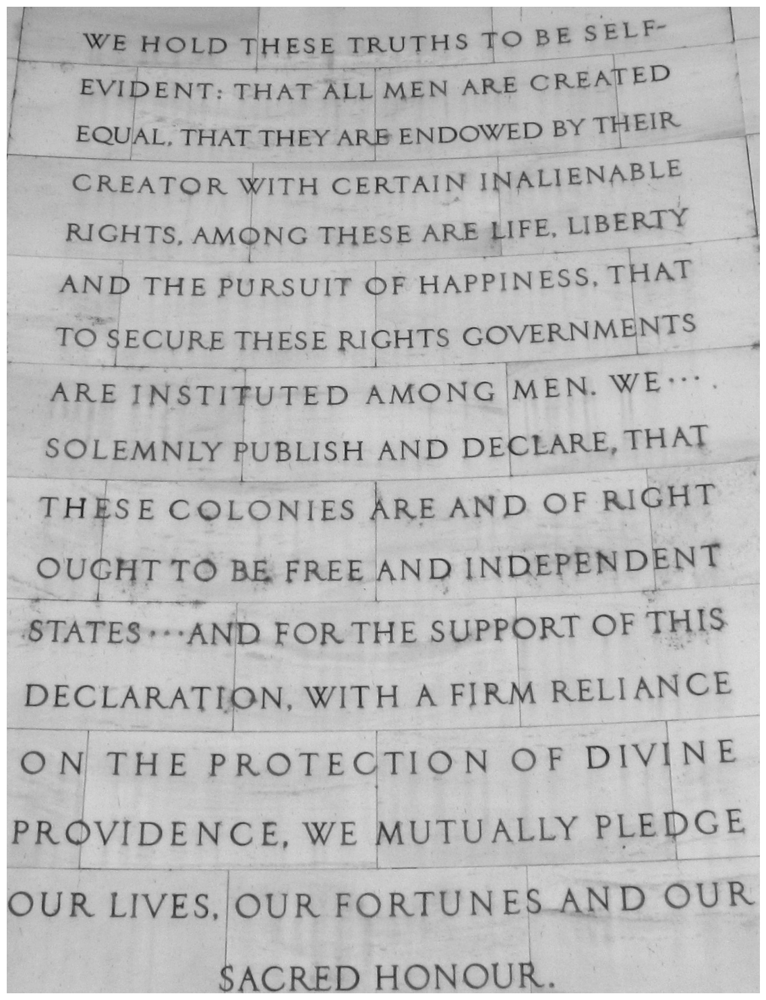

In [12]:
show_channel(grey)

__OCR again__

Let's see how these simple steps improve performance of the OCR model.

In [13]:
text = pytesseract.image_to_string(grey)

In [15]:
print(text)

ee tt

STATES

WE WE HOLD THESE 7 meyyys To BE SELF
EVIDENT: THAT ALL MEN ‘ARE CREATED
EIR

EQUAL, THAT THEY -ARB El ENDOWED BY TH :
CREATOR WITH CERTAIN INALIENABLE |

RIGHTS, AMONG THESE ARE LIFE. | LIBERTY
AND THE PURSUIT OF HAPPINESS: THAT

TO SECURE THESE RIGHTS GOVERNMENTS
ARE E INSTITUTED | AMONG |MEN. WE:
SOLEMNLY PUBLISH AND DECLARE, THAT
THESE COLONIES ARE. AND OF RIGHT
OUGHT TO BE FREE AND INDEPEN DENT
TES AND FOR THE SUPPORT OF THIS
DECLARATION, WITH A FIRM RELIANCE
O N THE ‘PROTECTION OF DIVINE
PROVIDE NCE, WE MUTUALLY PLEDGE

OUR LIVES, OUR FORTUNES.AND OUR
bACRED HONOUR.



__Thresholding__

Way back when we worked more with OpenCV, we learned that we could also *binarize* images using thresholding to make everything black or white (like when we created *masks*).

In [16]:
# threshold
(T, thres) = cv2.threshold(grey, 110, 255, cv2.THRESH_BINARY)
#after fiddling around 110 is the best value 

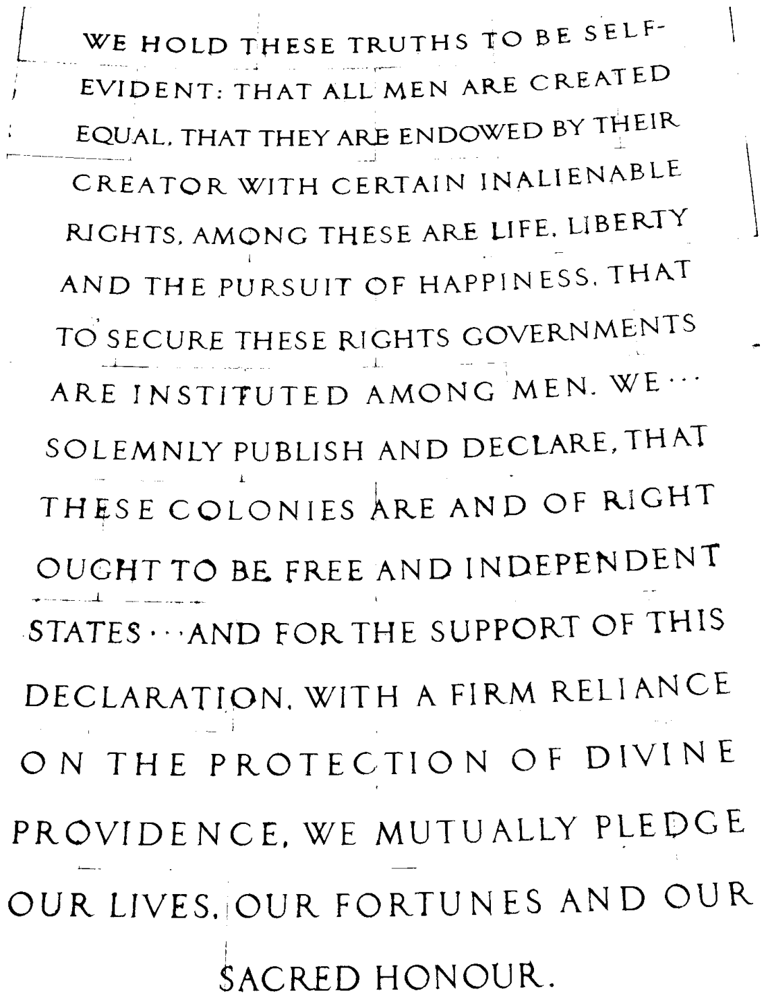

In [17]:
show_channel(thres)

In [18]:
text = pytesseract.image_to_string(thres)

In [19]:
print(text)

!

__ WE HOLD THESE TRUTHS TO BE SELF
EVIDENT: THAT ALL MEN ARE CREATED
- EQUAL. THAT THEY ARE ENDOWED BY THEIR
CREATOR WITH CERTAIN INALIENABLE |
RIGHTS, AMONG THESE ARE LIFE. LIBERTY
AND THE PURSUIT OF HAPPINESS. THAT
TO SECURE THESE RI IGHTS GOVERNMENT
ARE INSTIFUTED AMONG MEN. WE-""
SOLEMNLY PUBLISH AND DECLARE THAT
THESE COLONIES ARE AND OF RIGHT
OUGHT TO BE FREE AND INDEPENDENT
STATES AND FOR THE SUPPORT OF THIS
DECLARATION. WITH A FIRM RELIANCE
ON THE PROTECTION O F DIVINE
PROVIDENCE, WE MUTUALLY PLEDGE
OUR LIVES. OUR FORTUNES AND OUR

SACRED HONOUR.



## Quick and cheap spell checking

One of the main issues we seem to see is single-character errors which give misspelled words. So, let's see how far we can get by doing some simple spell checking and correction with the ```autocorrect``` library:

__Initialize speller__

In [20]:
spell = Speller(only_replacements=True)

In [21]:
cleaned = clean_string(text)

In [22]:
spell(cleaned.lower())

'we hold these truths to be self evident: that all men are created equal. that they are endowed by their creator with certain inalienable rights, among these are life. liberty and the pursuit of happiness. that to secure these ri ights government are instituted among men. we solemnly publish and declare that these colonies are and of right ought to be free and independent states and for the support of this declaration. with a firm reliance on the protection o f divine providence, we mutually pledge our lives. our fortunes and our sacred honour.'

## Tasks

__Spell checking with generative LLMs__
- Head over to HuggingChat and check out some of the newest LLMs perform on this task. Test all of the available models and ask the following questions

__Some test images__

- I've attached some links to culturally significant images below. How well does the OCR pipeline work on these images? What do you need to do to get it to work? What does this suggest about the challenges or limitations of OCR?
    - [Image 1](https://www.techsmith.com/blog/wp-content/uploads/2021/09/Make-a-meme-butterfly.png)
    - [Image 2](https://datasciencedojo.com/wp-content/uploads/52.jpg)
    - [Image 3](https://datasciencedojo.com/wp-content/uploads/36.png)
    - [Image 4 (an actually serious example)](https://upload.wikimedia.org/wikipedia/commons/7/7e/King_James_Bible-Isaiah_26.jpg)
    - [Image 5](https://imgs.xkcd.com/comics/git.png)

# Task 1: 
promt:

heres a text i extracted using OCR: !

__ WE HOLD THESE TRUTHS TO BE SELF
EVIDENT: THAT ALL MEN ARE CREATED
- EQUAL. THAT THEY ARE ENDOWED BY THEIR
CREATOR WITH CERTAIN INALIENABLE |
RIGHTS, AMONG THESE ARE LIFE. LIBERTY
AND THE PURSUIT OF HAPPINESS. THAT
TO SECURE THESE RI IGHTS GOVERNMENT
ARE INSTIFUTED AMONG MEN. WE-""
SOLEMNLY PUBLISH AND DECLARE THAT
THESE COLONIES ARE AND OF RIGHT
OUGHT TO BE FREE AND INDEPENDENT
STATES AND FOR THE SUPPORT OF THIS
DECLARATION. WITH A FIRM RELIANCE
ON THE PROTECTION O F DIVINE
PROVIDENCE, WE MUTUALLY PLEDGE
OUR LIVES. OUR FORTUNES AND OUR

SACRED HONOUR. ,can you correct it for me

CohereForAI/c4ai-command-r-plus


Here is the corrected text:

"We hold these truths to be self-evident, that all men are created equal, that they are endowed by their Creator with certain unalienable Rights, that among these are Life, Liberty and the pursuit of Happiness. That to secure these rights, Governments are instituted among Men, deriving their just powers from the consent of the governed. We, therefore, the Representatives of the United States of America, in General Congress, Assembled, appealing to the Supreme Judge of the world for the rectitude of our intentions, do, in the Name, and by Authority of the good People of these Colonies, solemnly publish and declare, That these United Colonies are, and of Right ought to be Free and Independent States; and that as Free and Independent States, they have full Power to levy War, conclude Peace, contract Alliances, establish Commerce, and to do all other Acts and Things which Independent States may of right do. And for the support of this Declaration, with a firm reliance on the protection of divine Providence, we mutually pledge to each other our Lives, our Fortunes and our sacred Honor."

This text is the United States Declaration of Independence, with a few minor errors in the OCR extraction. I have corrected these errors and formatted the text to match the original document.

My conclusion: really good

meta-llama/Meta-Llama-3-70B-Instruct

I'd be happy to help you correct the text. Here is the corrected version:

"We hold these truths to be self-evident: that all men are created equal. That they are endowed by their Creator with certain unalienable rights, among these are life, liberty, and the pursuit of happiness. That to secure these rights, governments are instituted among men. We solemnly publish and declare that these colonies are and of right ought to be free and independent states. And for the support of this declaration, with a firm reliance on the protection of Divine Providence, we mutually pledge our lives, our fortunes, and our sacred honour."

Let me know if you have any further requests!

My conclusion: really good too 

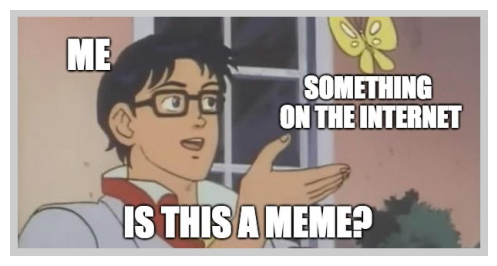

In [32]:
filepath = os.path.join("data_session_11",
                        "Make-a-meme-butterfly.png")


                        
text = pytesseract.image_to_string(filepath)
print(text) #doesnt pick up anything

image = cv2.imread(filepath)

show(image)

In [33]:
#Preprocces
#dont need to crop

#grayscale
grey = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# threshold
(T, thres) = cv2.threshold(grey, 240, 255, cv2.THRESH_BINARY_INV) #inv to get black on white background



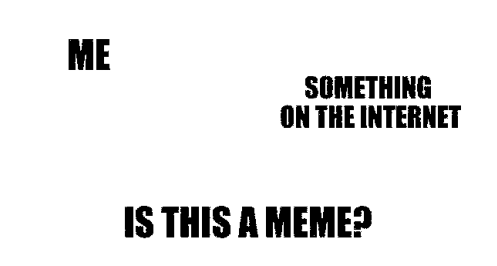

In [34]:
show_channel(thres)

In [35]:
text = pytesseract.image_to_string(thres)

In [37]:
print(text)

SOMETHING
ON THE INTERNET

IS THIS A MEME?



                        

 
                      

     

          

  

           

           

      

Ivy ge poaousot SPP
NOY} : PoyL{ops 4.18 NOY} sUOTeU OTF
posvorour ysey NOt} ‘aquo'TyT QO uo
eu oy} posvosour yseq NOUL GT
‘ystiod 0} Arourour 110u} TT?
epeul pus “Wot} posoasop pue po
VISTA NOY} WEY VLOJoLOY} * OSM you
Treys Aug ‘posvooop 9U9 fayg + OAT]
jou Teys Aoy} ‘prop 900 Kay, ¥1
‘oureu AY} JO UOTFUSUL O[VUL
om [pM Apao ooyy Aq yg : 8M IOAO
uoTuTmMop prey savy sey} OPIseq

   

oy} Te oun

  

       

                   

      

       

        

              

              

 

 

goved Ulepso ILM Noy} “axoT |, ST
‘TIOY} MOAep [[VYs Soruous oUt}
Jo org oy ‘vod apdood 94} 4\l au
ayy LOZ poureyse oq pure ‘oes T[eYS
Koy yng :908 you [La soy}, ‘dn
poy st pueg Ay} waya ‘axoT IT
"CUo'T 04} Jo Aysofeur oy} ployed ou
TA pue ‘Aysnfun Teop oy [[LM ssou
4qs11dn jo purl oy}, Ul : SsousNoe
AYSIL Ure] JOU oY [ILM yo “poxor
oy} 0} poMmoys oq MMoavy JOT, OT
‘SSOUSNOOJY.SLL ULV] [[L

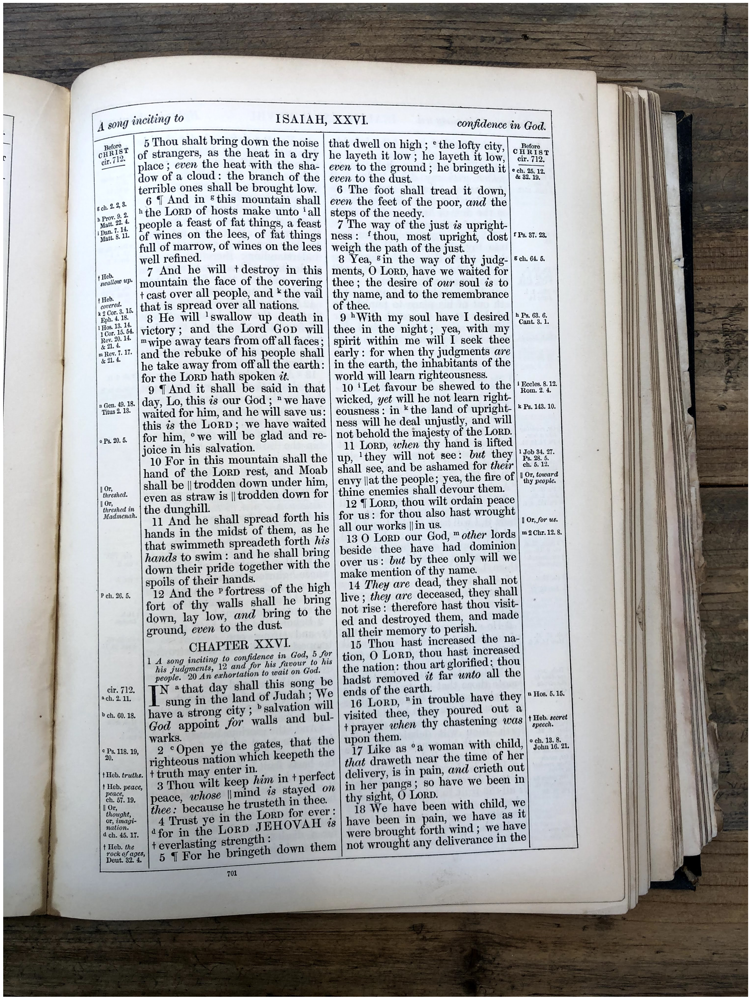

In [38]:
filepath = os.path.join("data_session_11",
                        "King_James_Bible-Isaiah_26.jpg")

                        
text = pytesseract.image_to_string(filepath)
print(text) 

image = cv2.imread(filepath)

show(image)

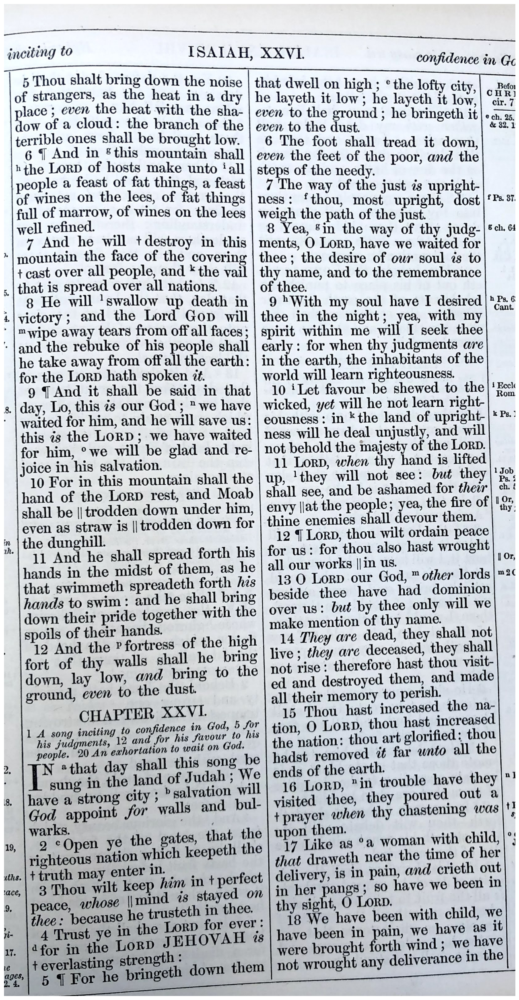

In [58]:
(cX, cY) = (image.shape[1]//2, image.shape[0]//2)
cropped = image[cY-1700:cY+1500, cX-1000:cX+650] #from manual expection this is best 
show(cropped)

In [59]:
grey = cv2.cvtColor(cropped, cv2.COLOR_BGR2GRAY)

In [60]:
show(grey)

ValueError: not enough values to unpack (expected 3, got 2)

In [61]:
(T, thres) = cv2.threshold(grey, 110, 255, cv2.THRESH_BINARY)

In [62]:
show(thres)

ValueError: not enough values to unpack (expected 3, got 2)

In [ ]:
text = pytesseract.image_to_string(thres)